# Install

In [ ]:
!pip install jupyter-dash -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.3/10.3 MB 85.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.6/233.6 kB 24.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 81.8 MB/s eta 0:00:00


In [ ]:
!pip install dash-cytoscape -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 38.0 MB/s eta 0:00:00


In [ ]:
!pip install opendatasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install category_encoders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.9/81.9 kB 3.8 MB/s eta 0:00:00


# Import

In [ ]:
# Utils
import random
import warnings
import numpy as np
import pandas as pd
import opendatasets as od
import missingno as msno
from category_encoders import BinaryEncoder

# Plot
import dash
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import dash_core_components as dcc
import dash_html_components as html
from jupyter_dash import JupyterDash
from dash.dependencies import Input, Output

<ipython-input-5-79f5e5477030>:17: UserWarning: 
The dash_core_components package is deprecated. Please replace
`import dash_core_components as dcc` with `from dash import dcc`
  import dash_core_components as dcc
<ipython-input-5-79f5e5477030>:18: UserWarning: 
The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`
  import dash_html_components as html


In [ ]:
warnings.simplefilter(action='ignore', category=FutureWarning)

# Download

In [ ]:
# {"username":"hauth7201","key":"3057ff45efdd5847796be879573f826c"}

path = 'https://www.kaggle.com/datasets/vanviethieuanh/vietnam-weather-data?fbclid=IwAR0I9LPl9GcBESRcLgMkufchT0TD_0pf8vlPzk-qRxcNdvVFUrGeTj28CIM'
od.download(path)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: hauth7201
Your Kaggle Key: ··········


100%|██████████| 1.88M/1.88M [00:00<00:00, 46.8MB/s]

In [ ]:
path = '/content/vietnam-weather-data/weather.csv'
df = pd.read_csv(path)

In [ ]:
number_of_row = len(df)
print('Number of row:', number_of_row)

Number of row: 181960


# Noising data

In [ ]:
# Convert data to date

df['date'] = pd.to_datetime(df['date'])
df = df.sort_values(['province', 'date'], ignore_index=True)

In [ ]:
def noising_data(df, column, frac, value):
  amount = int(number_of_row*frac)

  # index list of sample
  indices = np.random.choice(range(number_of_row), size=amount, replace=False)

  # Change value
  df.loc[indices, column] = value

> ## Add noise to feature

In [ ]:
noising_data(df, 'wind_d', 0.1, None)

In [ ]:
noising_data(df, 'max', 0.01, None)

In [ ]:
noising_data(df, 'humidi', 0.05, None)

# Statistic

In [ ]:
numerical_feature = ['max', 'min', 'wind', 'rain', 'humidi', 'cloud', 'pressure']
nominal_feature = ['province', 'wind_d']
time_series_feature = ['date']

In [ ]:
provinces = df['province'].unique()
print('Number of provinces:', len(provinces))
print('\nData:\n', provinces)

Number of provinces: 40

Data:
 ['Bac Lieu' 'Ben Tre' 'Bien Hoa' 'Buon Me Thuot' 'Ca Mau' 'Cam Pha'
 'Cam Ranh' 'Can Tho' 'Chau Doc' 'Da Lat' 'Ha Noi' 'Hai Duong' 'Hai Phong'
 'Hanoi' 'Ho Chi Minh City' 'Hoa Binh' 'Hong Gai' 'Hue' 'Long Xuyen'
 'My Tho' 'Nam Dinh' 'Nha Trang' 'Phan Rang' 'Phan Thiet' 'Play Cu'
 'Qui Nhon' 'Rach Gia' 'Soc Trang' 'Tam Ky' 'Tan An' 'Thai Nguyen'
 'Thanh Hoa' 'Tra Vinh' 'Tuy Hoa' 'Uong Bi' 'Viet Tri' 'Vinh' 'Vinh Long'
 'Vung Tau' 'Yen Bai']


In [ ]:
wind_d = df['wind_d'].unique()
print('Number of wind direction:', len(wind_d))
print('\nData:\n', wind_d)

Number of wind direction: 17

Data:
 ['NNE' 'ENE' 'ESE' None 'SE' 'E' 'NE' 'S' 'SSW' 'SSE' 'SW' 'WSW' 'W' 'WNW'
 'NW' 'N' 'NNW']


In [ ]:
df.describe()

,max,min,wind,rain,humidi,cloud,pressure
count,180141.000000,181960.000000,181960.000000,181960.000000,172862.000000,181960.000000,181960.000000
mean,29.838299,23.277874,11.038657,6.567130,77.089048,41.721268,1010.229127
std,4.570978,3.945381,5.311807,13.602055,9.288875,23.875067,4.635714
min,4.000000,2.000000,1.000000,0.000000,23.000000,0.000000,988.000000
25%,28.000000,21.000000,7.000000,0.100000,71.000000,23.000000,1008.000000
50%,31.000000,24.000000,10.000000,1.800000,78.000000,38.000000,1010.000000
75%,33.000000,26.000000,14.000000,7.500000,83.000000,58.000000,1012.000000
max,46.000000,32.000000,54.000000,596.400000,100.000000,100.000000,1038.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181960 entries, 0 to 181959
Data columns (total 10 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   province  181960 non-null  object        
 1   max       180141 non-null  float64       
 2   min       181960 non-null  int64         
 3   wind      181960 non-null  int64         
 4   wind_d    163764 non-null  object        
 5   rain      181960 non-null  float64       
 6   humidi    172862 non-null  float64       
 7   cloud     181960 non-null  int64         
 8   pressure  181960 non-null  int64         
 9   date      181960 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(3), int64(4), object(2)
memory usage: 13.9+ MB


<Axes: >

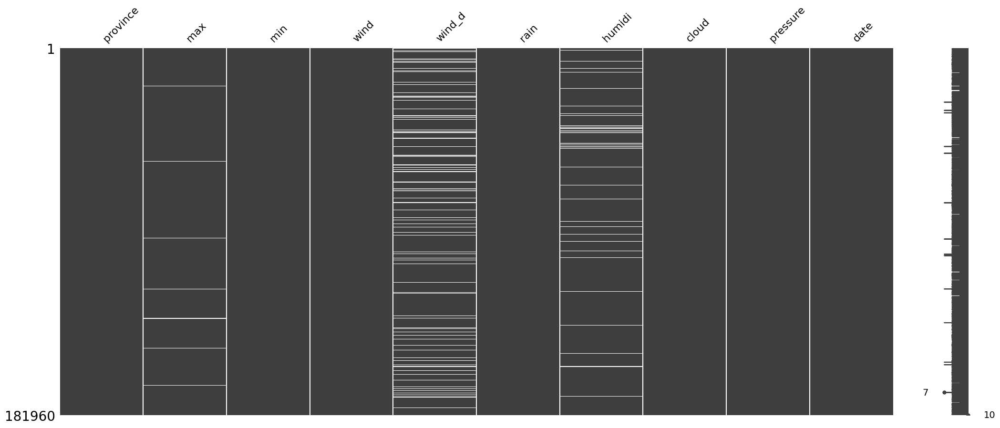

In [ ]:
# Check null/missing valaue
msno.matrix(df)

In [ ]:
# Save nosing data
path = "nosing_data.csv"
df.to_csv(path)

# Visualize

In [ ]:
def create_logical_array(size, index):
    logical_array = np.full(size, False)

    logical_array[index] = True

    return logical_array.tolist()

> ## Nominal feature

In [ ]:
# win_d histogram plot

fig = go.Figure()

num_province = len(provinces)

button_list = list([
    dict(label = 'All',
         method = 'update',
         args = [{'visible': [True]*num_province},
          {'showlegend':True}])
    ])

for i in range(num_province):
    fig.add_trace(
        go.Histogram(x=df[df['province']==provinces[i]]['wind_d'],
                     name=provinces[i])
    )

    button_list.append(
        dict(label = provinces[i],
             method = 'update',
             args = [{'visible': create_logical_array(num_province, i)},
              {'showlegend':True}])
    )

fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active=0,
        buttons=button_list
        )
    ])

fig.show()

In [ ]:
# wind_d count

df_wind = df.groupby('province')['wind_d'].value_counts().unstack()

> ## Numerical feature

In [ ]:
# Scatter plot province with other feature

# Tạo DataFrame mẫu
features = ['province', 'max', 'min', 'wind', 'wind_d', 'rain', 'humidi', 'cloud', 'pressure', 'date']
plot_df = df[features]

# Khởi tạo ứng dụng Dash
app = JupyterDash(__name__)

# Tạo layout cho ứng dụng Dash
app.layout = html.Div(
    children = [
        dcc.Graph(id='graph'),
        html.Div(children=[
            dcc.Dropdown(
                id='province-dropdown',
                options=[{'label': province, 'value': province} for province in provinces],
                value=plot_df['province'][0],
                style={
                      'width': '200px',
                      'margin-right': '10px',
                      'position': 'absolute',
                      'top': '10px',
                      'left': '50px'},
                placeholder='Select province'
            ),
            dcc.Dropdown(
                id='feature-dropdown',
                options=[{'label': feature, 'value': feature} for feature in plot_df.columns if feature not in ['province', 'date']],
                value='max',
                style={
                      'width': '200px',
                      'margin-right': '10px',
                      'position': 'absolute',
                      'top': '10px',
                      'left': '200px'},
                placeholder='Select feature'
            )]
        )
    ]
)

# Định nghĩa callback để cập nhật đồ thị dựa trên giá trị của hai dropdown menu
@app.callback(
    Output('graph', 'figure'),
    [Input('province-dropdown', 'value'), Input('feature-dropdown', 'value')]
)
def update_graph(province, feature):
    filtered_df = df[df['province'] == province]
    fig = px.scatter(filtered_df, x='date', y=feature, color='province')
    return fig

app.run_server(mode='inline')


Dash is running on http://127.0.0.1:8050/



INFO:dash.dash:Dash is running on http://127.0.0.1:8050/



<IPython.core.display.Javascript object>

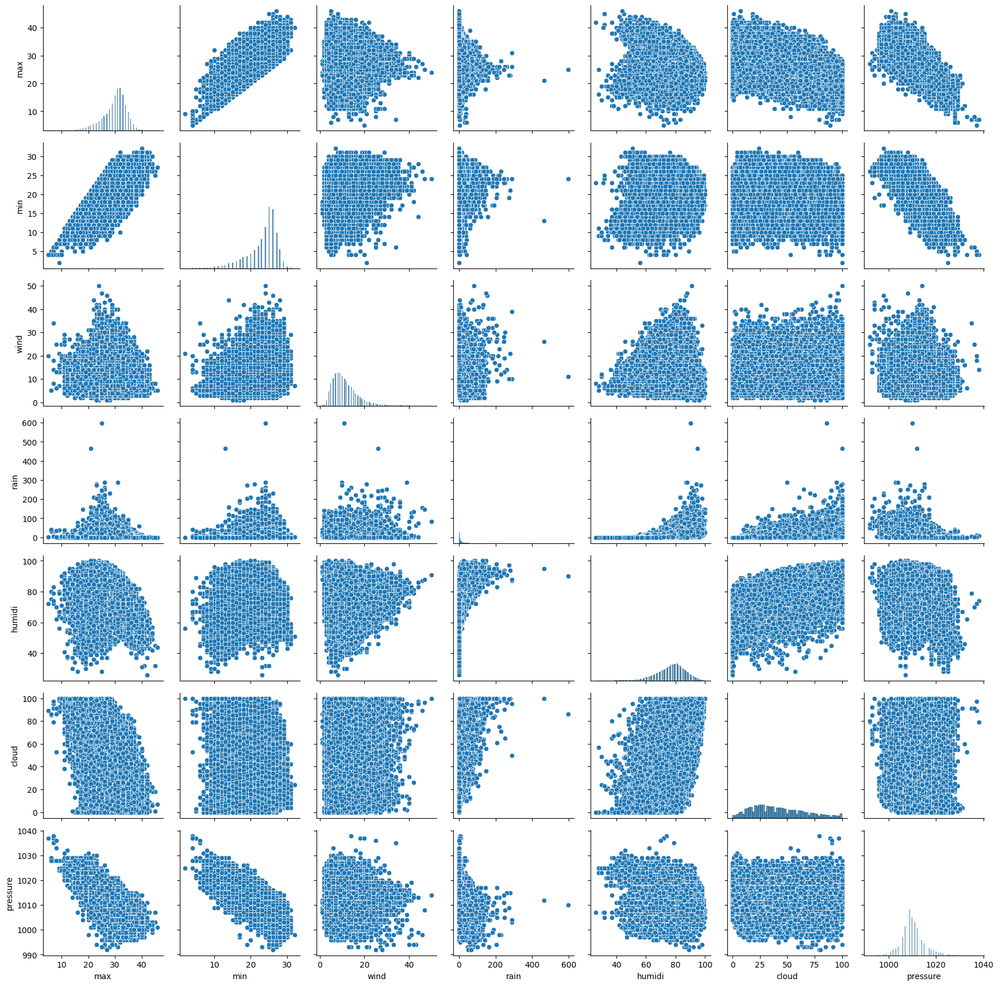

In [ ]:
# Scatter matrix plot

g = sns.PairGrid(df.sample(frac=0.3))
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [ ]:
# box plot

fig = go.Figure()

num_feature = len(numerical_feature)

button_list = list([])

for i in range(num_feature):
  fig.add_trace(
      go.Box(x = df['province'],
             y=df[numerical_feature[i]],
             name = numerical_feature[i])
      )

  button_list.append(
      dict(label = numerical_feature[i],
           method = 'update',
           args = [{'visible': create_logical_array(num_feature, i)}]
           )
      )

fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active=0,
        buttons=button_list,
        y=1
        )
    ])

fig.show()

In [ ]:
# outliers count

Q1 = df[numerical_feature].quantile(0.25)
Q3 = df[numerical_feature].quantile(0.75)
IQR = Q3 - Q1

In [ ]:
df_outliers = df[['province']+numerical_feature]

grouped = df_outliers.groupby('province')

outliers_count = grouped.apply(lambda x: ((x < (Q1 - 1.5 * IQR)) | (x > (Q3 + 1.5 * IQR))).sum()).drop('province', axis=1)

In [ ]:
#@title Total outlier of features


print("Total outliers:\n")
print('Total:', sum(outliers_count.sum()))
print()

feature_outlier_number = outliers_count.sum()
outliers_value_df = pd.DataFrame({'column name': feature_outlier_number.index,
                                 'number of outlier': feature_outlier_number.values,
                                 'percent of outlier': feature_outlier_number.values * 100 / len(df)})

outliers_value_df['percent of outlier'] = outliers_value_df['percent of outlier'].round(decimals=2)
outliers_value_df

Total outliers:

Total: 51530



,column name,number of outlier,percent of outlier
0,cloud,0,0.00
1,humidi,1929,1.06
2,max,8489,4.67
3,min,5200,2.86
4,pressure,14552,8.00
5,rain,17147,9.42
6,wind,4213,2.32


> ## Correlation

<Axes: >

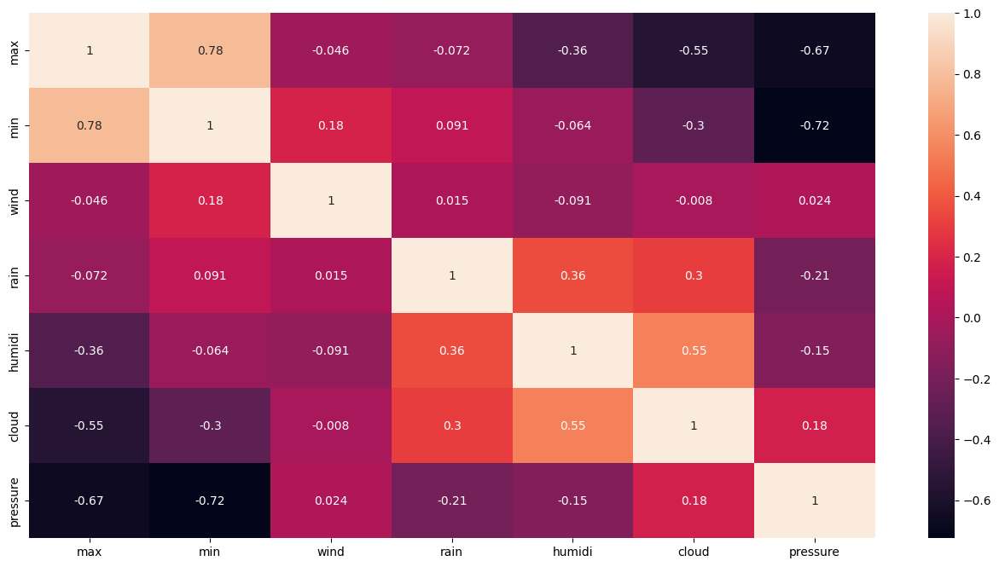

In [ ]:


plt.figure(figsize=(16, 8))
corr = df.corr()
sns.heatmap(corr, annot=True)

# Preprocessing

> ## Missing value

<Axes: >

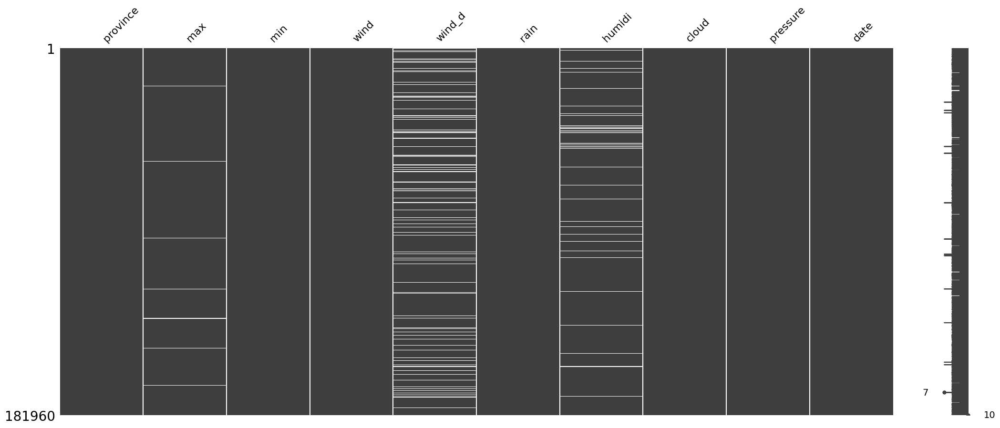

In [ ]:
# Check missing value

msno.matrix(df)

In [ ]:
missing_feature = ['max', 'wind_d', 'humidi']

In [ ]:
#@title Missing probability


# Missing probability

percent_missing = df[missing_feature].isnull().sum()
missing_value_df = pd.DataFrame({'column name': missing_feature,
                                 'number of null': percent_missing,
                                 'percent of missing': percent_missing * 100 / len(df)})

missing_value_df['percent of missing'] = missing_value_df['percent of missing'].round(decimals=2)
missing_value_df

,column name,number of null,percent of missing
max,max,1819,1.0
wind_d,wind_d,18196,10.0
humidi,humidi,9098,5.0


> ## Fill missing value

In [ ]:
# Fill max feature

df['max'] = df['max'].bfill()

In [ ]:
# Fill wind_d feature

df['wind_d'] = df['wind_d'].bfill()

In [ ]:
# Fill humidi feature

df['humidi'] = df['humidi'].interpolate()

> ## Categorical encoding

In [ ]:
created_feature = []

In [ ]:
encoded_df = df.copy()

In [ ]:
# Encode province feature

mean_rain_by_province = df.groupby('province')['rain'].mean()

In [ ]:
encoded_df['province_encoded'] = df['province'].map(mean_rain_by_province)
encoded_df = encoded_df.drop('province', axis=1)

In [ ]:
created_feature.append('province_encoded')

In [ ]:
encoded_df.head()

,max,min,wind,wind_d,rain,humidi,cloud,pressure,date,province_encoded
0,27.0,22,17,NNE,6.9,90.0,71,1010,2009-01-01,3.455858
1,28.0,22,15,ENE,0.5,85.0,61,1010,2009-01-02,3.455858
2,23.0,21,9,ESE,16.7,91.0,77,1011,2009-01-03,3.455858
3,27.0,21,9,SE,2.2,86.0,32,1011,2009-01-04,3.455858
4,29.0,22,10,SE,0.0,81.0,25,1010,2009-01-05,3.455858


In [ ]:
# Encode wind feature

encoder = BinaryEncoder(cols=['wind_d'])
encoded_df = encoder.fit_transform(encoded_df)
encoded_df

,max,min,wind,wind_d_0,wind_d_1,wind_d_2,wind_d_3,wind_d_4,rain,humidi,cloud,pressure,date,province_encoded
0,27.0,22,17,0,0,0,0,1,6.9,90.0,71,1010,2009-01-01,3.455858
1,28.0,22,15,0,0,0,1,0,0.5,85.0,61,1010,2009-01-02,3.455858
2,23.0,21,9,0,0,0,1,1,16.7,91.0,77,1011,2009-01-03,3.455858
3,27.0,21,9,0,0,1,0,0,2.2,86.0,32,1011,2009-01-04,3.455858
4,29.0,22,10,0,0,1,0,0,0.0,81.0,25,1010,2009-01-05,3.455858
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181955,32.0,23,6,0,0,0,1,1,7.3,79.0,71,1001,2021-06-14,9.170103
181956,34.0,25,6,0,1,0,0,1,0.3,71.0,46,999,2021-06-15,9.170103
181957,36.0,27,6,0,0,1,1,1,0.0,64.0,29,1000,2021-06-16,9.170103
181958,37.0,28,7,0,0,1,1,1,0.0,66.0,27,1002,2021-06-17,9.170103


In [ ]:
# Encoded feature

binary_wind_d_feature = ['wind_d_0',	'wind_d_1',	'wind_d_2',	'wind_d_3',	'wind_d_4']
created_feature = created_feature + binary_wind_d_feature

In [ ]:
# Separate day feature in encoded_df

encoded_df['Day'] = encoded_df['date'].dt.day
encoded_df['Month'] = encoded_df['date'].dt.month
encoded_df['Year'] = encoded_df['date'].dt.year

In [ ]:
# Separate day feature in df

df['Day'] = df['date'].dt.day
df['Month'] = df['date'].dt.month
df['Year'] = df['date'].dt.year

In [ ]:
encoded_df = encoded_df.drop('date', axis=1)

In [ ]:
encoded_df

,max,min,wind,wind_d_0,wind_d_1,wind_d_2,wind_d_3,wind_d_4,rain,humidi,cloud,pressure,province_encoded,Day,Month,Year
0,27.0,22,17,0,0,0,0,1,6.9,90.0,71,1010,3.455858,1,1,2009
1,28.0,22,15,0,0,0,1,0,0.5,85.0,61,1010,3.455858,2,1,2009
2,23.0,21,9,0,0,0,1,1,16.7,91.0,77,1011,3.455858,3,1,2009
3,27.0,21,9,0,0,1,0,0,2.2,86.0,32,1011,3.455858,4,1,2009
4,29.0,22,10,0,0,1,0,0,0.0,81.0,25,1010,3.455858,5,1,2009
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181955,32.0,23,6,0,0,0,1,1,7.3,79.0,71,1001,9.170103,14,6,2021
181956,34.0,25,6,0,1,0,0,1,0.3,71.0,46,999,9.170103,15,6,2021
181957,36.0,27,6,0,0,1,1,1,0.0,64.0,29,1000,9.170103,16,6,2021
181958,37.0,28,7,0,0,1,1,1,0.0,66.0,27,1002,9.170103,17,6,2021


In [ ]:
separate_date_feature = ['Day', 'Month', 'Year']
created_feature = created_feature + separate_date_feature

## Outlier data

# Data preparation

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [ ]:
def data_split(df):
  train_data, val_data = train_test_split(df, test_size=0.2, random_state=42)

  x_train = train_data.drop('rain', axis=1)
  y_train = train_data['rain']

  x_val = val_data.drop('rain', axis=1)
  y_val = val_data['rain']

  return x_train, y_train, x_val, y_val

In [ ]:
# Data splitting

x_train, y_train, x_val, y_val = data_split(encoded_df)

In [ ]:
# Validation data

province = 'Bac Lieu'
x_province_val = x_val[x_val['province_encoded']==mean_rain_by_province[province]]
x_province_val = x_province_val.sort_values(['Year', 'Month', 'Day'])
y_province_val = y_val[y_val.index.isin(x_province_val.index)]

# Modeling

> ## Import

In [ ]:
import xgboost as xgb
import lightgbm as lgb

from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from hyperopt import tpe, hp, fmin, STATUS_OK,Trials
from hyperopt.pyll.base import scope

> ## Utils

In [ ]:
def validation_plot(y_pred, y_val):
  fig = go.Figure()

  # Thêm dữ liệu y_val vào figure
  fig.add_trace(go.Scatter(x=list(range(len(y_val))), y=y_val, mode='lines', name='y_val'))

  # Thêm dữ liệu y_predict vào figure
  fig.add_trace(go.Scatter(x=list(range(len(y_pred))), y=y_pred, mode='lines', name='y_predict'))

  fig.update_layout(title=f'Compare y_val and y_predict ({province} province)',
                    xaxis_title='Index',
                    yaxis_title='Rain',
                    showlegend=True)

  fig.show()

> ## Random Forest Regression


>> ### Hyperparameter tuning

In [ ]:
# Function
def hyperparameter_tuning(params):
    clf = RandomForestRegressor(**params,n_jobs=-1)
    loss = cross_val_score(clf, x_train, y_train, scoring="neg_mean_squared_error").mean()
    return {"loss": -loss, "status": STATUS_OK}


# Parameter range
est_range = list(range(2, 16, 2))


# Check n_estimators in range 100 - 200
space = {
    "n_estimators": hp.choice("n_estimators", est_range)
}


# Initialize trials object: Result = n_estimators=7
trials = Trials()

best = fmin(
    fn=hyperparameter_tuning,
    space = space,
    algo=tpe.suggest,
    max_evals=10,
    trials=trials
)

print("Best: {}".format(best))

100%|██████████| 10/10 [03:20<00:00, 20.02s/trial, best loss: 76.31934939457027]
Best: {'n_estimators': 6}


>> ### Traning

In [ ]:
RF_regressor = RandomForestRegressor(
    n_estimators=est_range[best['n_estimators']],
    random_state=0
)

In [ ]:
RF_regressor.fit(x_train, y_train)

RandomForestRegressor(n_estimators=14, random_state=0)

>> ### Validation

In [ ]:
y_pred = RF_regressor.predict(x_province_val)

In [ ]:
validation_plot(y_pred, y_province_val)

In [ ]:
# Đánh giá mô hình
mae = mean_absolute_error(y_province_val, y_pred)
mse = mean_squared_error(y_province_val, y_pred)
r2 = r2_score(y_province_val, y_pred)

print("Mean Absolute Error:", mae)
print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Absolute Error: 4.518750967342517
Mean Squared Error: 46.203560760165395
R-squared: -0.5796555008803594


> ## Gradient boost

>> ### Hyperparameter tuning

In [ ]:
# Function
def hyperparameter_tuning(params):
    clf = GradientBoostingRegressor(**params)
    loss = cross_val_score(clf, x_train, y_train, scoring="neg_mean_squared_error").mean()
    return {"loss": -loss, "status": STATUS_OK}


# Parameter range
est_range = list(range(1, 20, 4))
lr_range = np.arange(0.1, 2.0, 0.5)


# Check n_estimators in range 100 - 200
space = {
    "n_estimators": hp.choice("n_estimators", est_range),
    "learning_rate": hp.choice("learning_rate", lr_range)
}


# Initialize trials object: Result = n_estimators=7
trials = Trials()

best = fmin(
    fn=hyperparameter_tuning,
    space = space,
    algo=tpe.suggest,
    max_evals=20,
    trials=trials
)

print("Best: {}".format(best))

100%|██████████| 20/20 [02:25<00:00,  7.26s/trial, best loss: 111.16263587155208]
Best: {'learning_rate': 1, 'n_estimators': 4}


>> ### Traning

In [ ]:
GB_regressor = GradientBoostingRegressor(
    n_estimators = est_range[best['n_estimators']],
    learning_rate = lr_range[best['learning_rate']],
    random_state=4
)

In [ ]:
GB_regressor.fit(x_train, y_train)

GradientBoostingRegressor(learning_rate=0.6, n_estimators=17, random_state=4)

>> ### Validation

In [ ]:
y_pred = GB_regressor.predict(x_province_val)

In [ ]:
validation_plot(y_pred, y_province_val)

In [ ]:
# Đánh giá mô hình
mae = mean_absolute_error(y_province_val, y_pred)
mse = mean_squared_error(y_province_val, y_pred)
r2 = r2_score(y_province_val, y_pred)

print("Mean Absolute Error:", mae)
print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Absolute Error: 4.602800782050706
Mean Squared Error: 43.7043394521462
R-squared: -0.49420951745014663


> ## Xgboost

>> ### Hyperparameter tuning

In [ ]:
# Function
def hyperparameter_tuning(params):
    clf = xgb.XGBRegressor(**params)
    loss = cross_val_score(clf, x_train, y_train, scoring="neg_mean_squared_error").mean()
    return {"loss": -loss, "status": STATUS_OK}


# Parameter range
lr_range = np.arange(0.1, 1.6, 0.2)
est_range = np.arange(1, 20, 4)
mdeep_range = np.arange(1, 6)
colevel_range = np.arange(0.1, 1, 0.1)
policy_range = ['lossguide', 'depthwise']


# Check n_estimators in range 100 - 200
space = {
    'learning_rate': hp.choice("learning_rate", lr_range),
    'n_estimators': hp.choice("n_estimators", est_range),
    'max_depth': hp.choice("max_depth", mdeep_range),
    'colsample_bylevel': hp.choice("colsample_bylevel", colevel_range)
}


# Initialize trials object: Result = n_estimators=7
trials = Trials()

best = fmin(
    fn = hyperparameter_tuning,
    space = space,
    algo = tpe.suggest,
    max_evals = 40,
    trials = trials
)

print("Best: {}".format(best))

100%|██████████| 40/40 [01:22<00:00,  2.05s/trial, best loss: 101.41125211269541]
Best: {'colsample_bylevel': 4, 'learning_rate': 3, 'max_depth': 4, 'n_estimators': 3}


>> ### Training

In [83]:
xgb_preressor = xgb.XGBRegressor(
    learning_rate = lr_range[best['learning_rate']],
    n_estimators = est_range[best['learning_rate']],
    max_depth = mdeep_range[best['learning_rate']],
    colsample_bylevel = colevel_range[best['learning_rate']],
    grow_policy='lossguide'
)

In [84]:
xgb_preressor.fit(x_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=0.4, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy='lossguide',
             importance_type=None, interaction_constraints=None,
             learning_rate=0.7000000000000001, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=13, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [85]:
xgb_preressor.score(x_train, y_train)

0.4564884229014434

>> ### Validation

In [86]:
y_pred = GB_regressor.predict(x_province_val)

In [87]:
validation_plot(y_pred, y_province_val)

In [88]:
# Đánh giá mô hình
mae = mean_absolute_error(y_province_val, y_pred)
mse = mean_squared_error(y_province_val, y_pred)
r2 = r2_score(y_province_val, y_pred)

print("Mean Absolute Error:", mae)
print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Absolute Error: 4.602800782050706
Mean Squared Error: 43.7043394521462
R-squared: -0.49420951745014663


> ## Lightgbm

>> ### Training

In [ ]:
# Tạo bộ dữ liệu huấn luyện của LightGBM
train_data = lgb.Dataset(x_train, label=y_train)

In [ ]:
params = {
    'objective': 'regression',
    'boosting': 'goss',
    'learning_rate': 0.5,
    'max_depth': 6,
    'num_leaves': 20
}

In [ ]:
LGB_regressor = lgb.train(
    params,
    train_data,
)

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004327 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 555
[LightGBM] [Info] Number of data points in the train set: 145568, number of used features: 15
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] Start training from score 6.577009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
